In [53]:
from radiomics.featureextractor import RadiomicsFeaturesExtractor
import radiomics
import h5py
import matplotlib.pyplot as plt
from skimage import measure
import numpy as np
import pandas as pd
import SimpleITK as sitk
%matplotlib inline

In [2]:
DATASET_FILE = "/mnt/Data/LUNA/dataset_1mm.hdf5"
ANNOTATIONS_FILE = "/mnt/Data/LUNA/CSVFILES/annotations.csv"

In [3]:
dataset = h5py.File(DATASET_FILE)
ann_df = pd.read_csv(ANNOTATIONS_FILE)

In [4]:
list(dataset.keys())

['ct_scans', 'lung_masks', 'nodule_masks_bbox', 'nodule_masks_spherical']

In [5]:
seriesuids = list(dataset["ct_scans"].keys())
sid = seriesuids[0]

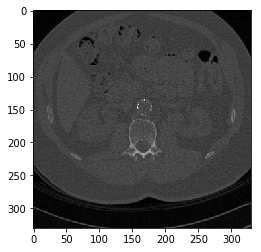

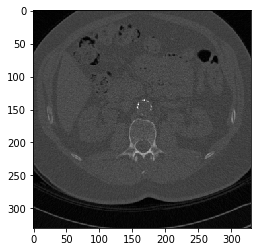

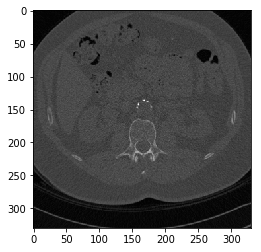

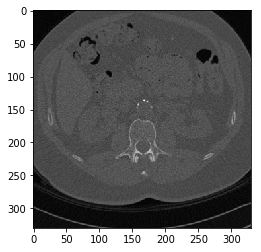

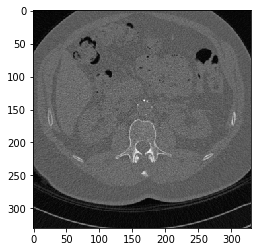

...

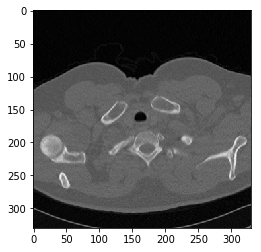

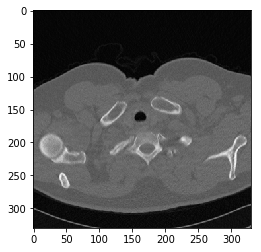

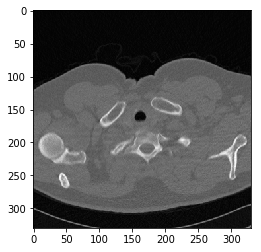

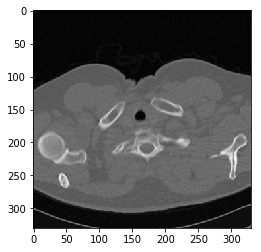

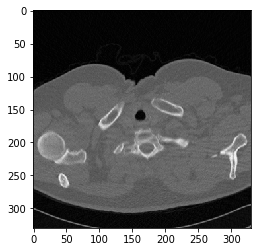

In [6]:
for z in range(dataset["ct_scans"][sid].shape[0]):
    d = dataset["ct_scans"][sid]
    plt.imshow(d[z,:,:], cmap="gray")
    plt.show()

In [7]:
d = dataset["nodule_masks_spherical"][sid]
labels = measure.label(d.value)
props = measure.regionprops(labels)

In [8]:
print(np.unique(labels))
print(props[0].centroid)

[0 1 2]
(140.26041666666666, 136.07291666666666, 28.979166666666668)


In [45]:
def dataset_to_sitk(arr, origin, spacing=(1.0, 1.0, 1.0)):
    img = sitk.GetImageFromArray(arr)
    img.SetSpacing(spacing)
    img.SetOrigin(origin)
    return img

In [66]:
radiomics_extractor = RadiomicsFeaturesExtractor()
radiomics_extractor.enableAllFeatures()
radiomics_extractor.enableImageTypes(**{"Original":{}, "LoG":{}})
#radiomics_extractor.enableImageTypeByName("original")
#radiomics_extractor.enableImageTypeByName("log")

In [67]:
origin = dataset["ct_scans"][sid].attrs["origin"]
img_scan = dataset_to_sitk(dataset["ct_scans"][sid].value, origin)
img_mask = dataset_to_sitk(measure.label(dataset["nodule_masks_spherical"][sid].value), origin)

In [68]:
%%time
img_feature_list = []
features = radiomics_extractor.execute(img_scan, img_mask, label=1)
image_features = {f: features[f] for f in features.keys() if "general_" not in f}
img_feature_list.append(image_features)

features = radiomics_extractor.execute(img_scan, img_mask, label=2)
image_features = {f: features[f] for f in features.keys() if "general_" not in f}
img_feature_list.append(image_features)


calculateFeatures() is deprecated, use execute() instead.
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated
calculateFeatures() is deprecated, use execute() instead.
GLCM is symmetrical, therefore Sum Average = 2 * Joint Average, only 1 needs to be calculated


CPU times: user 9.83 s, sys: 590 ms, total: 10.4 s
Wall time: 4.44 s


In [65]:
pd.DataFrame(img_feature_list)

,original_firstorder_10Percentile,original_firstorder_90Percentile,original_firstorder_Energy,original_firstorder_Entropy,original_firstorder_InterquartileRange,original_firstorder_Kurtosis,original_firstorder_Maximum,original_firstorder_Mean,original_firstorder_MeanAbsoluteDeviation,original_firstorder_Median,...,wavelet-LLL_glszm_SmallAreaHighGrayLevelEmphasis,wavelet-LLL_glszm_SmallAreaLowGrayLevelEmphasis,wavelet-LLL_glszm_ZoneEntropy,wavelet-LLL_glszm_ZonePercentage,wavelet-LLL_glszm_ZoneVariance,wavelet-LLL_ngtdm_Busyness,wavelet-LLL_ngtdm_Coarseness,wavelet-LLL_ngtdm_Complexity,wavelet-LLL_ngtdm_Contrast,wavelet-LLL_ngtdm_Strength
0,-590.0,18.5,12910597.0,4.840440,371.00,2.065293,138.0,-288.614583,191.943142,-316.0,...,2468.262658,0.014885,5.854290,0.822917,0.244833,0.013194,0.031523,30723.167107,5.904099,102.660850
1,-733.5,-348.0,11245200.0,3.798145,150.25,2.485497,-267.0,-543.055556,103.830247,-550.0,...,584.467742,0.047025,4.760648,0.861111,0.135276,0.026612,0.070738,5210.662577,4.688085,51.726424


In [40]:
features

OrderedDict()

In [55]:
radiomics.getImageTypes()

['Exponential',
 'Gradient',
 'LBP2D',
 'LBP3D',
 'LoG',
 'Logarithm',
 'Original',
 'Square',
 'SquareRoot',
 'Wavelet']